<a href="https://colab.research.google.com/github/junweilam/2105_Lab01/blob/master/ICT3104_Team20.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installation of packages

Before running the functions in this project, make sure to run this cell to install all necessary dependencies.


**Installing of necessary dependencies**

In [ ]:
!pip install ipywidgets==7.6.3
!pip install pyyaml
!pip install opencv-python-headless
!pip install accelerate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.8/121.8 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 31.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 57.0 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.6
    Uninstalling widgetsnbextension-3.6.6:
      Successfully uninstalled widgetsnbextension-3.6.6
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 0.10.0 requires ipywidgets>=7.7.1, but you have ipywidgets 7.6.3 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.0/261.0 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
!nvidia-smi --query-gpu=name,memory.total,memory.free --format=csv,noheader

Tesla T4, 15360 MiB, 15101 MiB


**Installation for Debugger**

In [ ]:
#Debugger
!pip install -Uqq ipdb
import ipdb

**Debugger Switch (On/Off)**

In [ ]:
# Turn On Debugger
%pdb on

# Turn Off Debugger
# %pdb off

Automatic pdb calling has been turned ON


Mounting google drive to google colab, and create a new folder directory to store all folder that we are going to create inside for this project

In [ ]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')
import os

# Path to your Google Drive folder
drive_path = '/content/drive/MyDrive/'

# Name of the new folder you want to create
new_folder_name = 'ICT3104'

# Check if the folder already exists, if not, create it
new_folder_path = os.path.join(drive_path, new_folder_name)
if not os.path.exists(new_folder_path):
    os.makedirs(new_folder_path)
    print(f"Directory '{new_folder_name}' created successfully.")
else:
    print(f"Directory '{new_folder_name}' already exists.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Directory 'ICT3104' already exists.


Download from Sim4Action github and unzipped the file.

In [ ]:
from IPython.display import Video, display, HTML
from moviepy.editor import *
import ipywidgets as widgets
import base64

%cd /content
# Specify the file URL and local file name
file_url = "https://cvhci.anthropomatik.kit.edu/~aroitberg/datasets/sims4action/Sims4ActionVideos.zip"
file_name = "Sims4ActionVideos.zip"
extracted_folder = "Sims4ActionVideos"

# Check if the file already exists in the current directory
if not os.path.exists(file_name):
    # If the file doesn't exist, download it
    !wget $file_url
else:
    print(f"File '{file_name}' already exists. Skipping download.")

# Check if the extracted folder already exists
if not os.path.exists(extracted_folder):
    # If the folder doesn't exist, unzip the file
    !unzip -q $file_name
else:
    print(f"Folder '{extracted_folder}' already exists. Skipping extraction.")

# Check if the folder exists
if os.path.exists(extracted_folder):
    # Get a list of subfolders in the extracted folder
    subfolders = [folder for folder in os.listdir(extracted_folder) if os.path.isdir(os.path.join(extracted_folder, folder))]

    # Check if there are any subfolders
    if subfolders:
        # Create a dropdown widget with subfolder options
        folder_dropdown = widgets.Dropdown(
            options=subfolders,
            description='Select Folder:'
        )

        # Get the path of the selected subfolder
        selected_folder = os.path.join(extracted_folder, folder_dropdown.value)

        # Get a list of AVI video files in the selected subfolder
        video_files = [file for file in os.listdir(selected_folder) if file.endswith('.avi')]

        # Create a dropdown widget with AVI video file options
        video_dropdown = widgets.Dropdown(
            options=video_files,
            description='Select Video:'
        )

        # Function to handle folder dropdown change event
        def on_folder_change(change):
            selected_folder = os.path.join(extracted_folder, folder_dropdown.value)
            video_files = [file for file in os.listdir(selected_folder) if file.endswith('.avi')]
            video_dropdown.options = video_files

        # Attach the function to the folder dropdown's change event
        folder_dropdown.observe(on_folder_change, names='value')


        # Attach the function to the video dropdown's change event
        video_dropdown.observe(on_video_change, names='value')

        # Create a button widget for playing the selected video
        play_button = widgets.Button(description="Select Video")

        # Function to handle button click event
        def play_video(event):
            selected_folder = os.path.join(extracted_folder, folder_dropdown.value)
            selected_video = video_dropdown.value
            video_path = os.path.join(selected_folder, selected_video)
            avi_path = video_path
            mp4_name = selected_video.split('.')[0]
            os.makedirs("input/", exist_ok=True)
            mp4_file = f"/content/input/{mp4_name}.mp4"
            video = VideoFileClip(avi_path)
            video.write_videofile(mp4_file, codec='libx264')
            print(mp4_file)
            # display(Video(mp4_file, width=420, height=420))  # Adjust width and height as needed, autoplay set to True

            mp4 = open(mp4_file,'rb').read()
            data_url = "data:video/mp4;base64," + base64.b64encode(mp4).decode()
            display(HTML(f"""<video width="400" controls><source src="{data_url}" type="video/mp4"></video>"""))

        # Attach the function to the button's click event
        play_button.on_click(play_video)

        # Display the folder and video dropdown widgets, and the play button
        display(folder_dropdown)
        display(video_dropdown)
        display(play_button)
    else:
        print("No subfolders found in the extracted folder.")
else:
    print(f"Folder '{extracted_folder}' not found.")

chunk:   0%|          | 1/1333 [00:28<10:21:59, 28.02s/it, now=None]

Moviepy - Building video /content/input/Wa_S2D1_fC2.mp4.
MoviePy - Writing audio in Wa_S2D1_fC2TEMP_MPY_wvf_snd.mp3



chunk:   0%|          | 1/1333 [00:30<11:21:31, 30.70s/it, now=None]

MoviePy - Done.
Moviepy - Writing video /content/input/Wa_S2D1_fC2.mp4




chunk:   0%|          | 1/1333 [01:04<23:51:01, 64.46s/it, now=None]

Moviepy - Done !
Moviepy - video ready /content/input/Wa_S2D1_fC2.mp4
/content/input/Wa_S2D1_fC2.mp4


chunk:   0%|          | 1/1333 [01:04<23:54:40, 64.63s/it, now=None]

Moviepy - Building video /content/input/Wa_S2D1_fC2.mp4.
MoviePy - Writing audio in Wa_S2D1_fC2TEMP_MPY_wvf_snd.mp3



chunk:   0%|          | 1/1333 [01:07<24:54:55, 67.34s/it, now=None]

MoviePy - Done.
Moviepy - Writing video /content/input/Wa_S2D1_fC2.mp4




chunk:   0%|          | 1/1333 [01:37<36:11:03, 97.80s/it, now=None]

Moviepy - Done !
Moviepy - video ready /content/input/Wa_S2D1_fC2.mp4
/content/input/Wa_S2D1_fC2.mp4


/content
File 'Sims4ActionVideos.zip' already exists. Skipping download.
Folder 'Sims4ActionVideos' already exists. Skipping extraction.


Dropdown(description='Select Folder:', options=('Walk', 'Drink', 'WatchTV', 'GetupSitdown', 'Usetablet', 'Usep…

Dropdown(description='Select Video:', options=('Wa_S2D1_fC4.avi', 'Wa_S2D1_fC2.avi', 'Wa_S8L2_fC23.avi', 'Wa_S…

Button(description='Select Video', style=ButtonStyle())

# **Uploading Of Input Video File in .mp4 format** (T20-1)


---


1.   Run the cell and click the "Upload" button to upload a video in .mp4 format
2.   Once file is selected, click "Save MP4" button to save the .mp4 file
3.   File is saved when progress bar is 100% green and "Save MP4" button is changed to "MP4 Saved!"



In [ ]:
# Testing.ipynb

import ipywidgets as widgets
from IPython.display import display
import os
import shutil
import asyncio
import platform
import time
from base64 import b64encode

print("Uploaded MP4 File will be saved into ./input/")
# Create a file uploader widget
file_upload = widgets.FileUpload(
    accept='.mp4',
    multiple=False
)

# Create a button widget
save_button = widgets.Button(
    description="Save MP4",
    disabled=False,
    button_style='success'
)

# Create a progress widget
progress = widgets.FloatProgress(
    value=0,
    min=0,
    max=100,
    bar_style="success"
)

def update_progress_bar():
  progress.value += 25
  time.sleep(1)

def save_mp4(b):
    if file_upload.value:
        # Get the uploaded file
        uploaded_file = list(file_upload.value.values())[0]

        update_progress_bar()

        # Specify the destination folder to save the file
        destination_folder = './input'

        update_progress_bar()

        # Create the destination folder if it doesn't exist
        if not os.path.exists(destination_folder):
            os.makedirs(destination_folder)

        update_progress_bar()

        with open(os.path.join(destination_folder, uploaded_file['metadata']['name']), 'wb') as f:
            f.write(uploaded_file['content'])

        update_progress_bar()

        # Disable the file uploaded and update the button text
        file_upload.disabled = True
        save_button.description = "MP4 Saved!"
    else:
        print("Please upload an MP4 file first")

display(file_upload, save_button, progress)

save_button.on_click(save_mp4)

Uploaded MP4 File will be saved into ./input/


FileUpload(value={}, accept='.mp4', description='Upload')

Button(button_style='success', description='Save MP4', style=ButtonStyle())

FloatProgress(value=0.0, bar_style='success')

# **Viewing of uploaded videos** (T20-21)

1.   Videos uploaded will be shown in the drop down list.
2.   Select a video.
3.   Click the "Play Video" button to display and view the video

In [ ]:
# Testing .ipynb
import os
from IPython.display import Video, display, HTML
import ipywidgets as widgets

%cd "/content"
# Path to the input directory
input_directory = './input'
video_files = []
if os.path.exists(input_directory):
  # Get a list of video files in the input directory
  video_files = [file for file in os.listdir(input_directory) if file.endswith('.mp4')]

# Create a dropdown widget with video file options
video_dropdown = widgets.Dropdown(
    options=video_files,
    description='Select Video:'
)


# Create a button widget for playing the selected video
play_button = widgets.Button(description="Play Video")

# Function to handle button click event
def play_video(event):
    selected_video = video_dropdown.value
    video_path = os.path.join(input_directory, selected_video)
    # display(Video(video_path, width=640, height=360))  # Adjust width and height as needed

    # For Google Collab
    mp4 = open(video_path,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    display(HTML("""<video width=400 controls><source src="%s" type="video/mp4"></video>""" % data_url))


# Attach the function to the button's click event
play_button.on_click(play_video)

# Display the dropdown and button widgets
display(video_dropdown)
display(play_button)

/content


Dropdown(description='Select Video:', options=('output.mp4', 'TrainingVideo.mp4', 'Wa_S2D1_fC2.mp4'), value='o…

Button(description='Play Video', style=ButtonStyle())

# Create a pose skeleton(MMPose) of the character in the video doing the same action. (T20-4)

In [ ]:
# %pip install -U openmim
# !mim install mmengine
# !mim install "mmcv>=2.0.0"
# !mim install "mmdet>=3.0.0"

###Install MMPose from source

In [ ]:
# %cd /content
# !git clone https://github.com/open-mmlab/mmpose.git
# %cd mmpose
# !pip install -e .

### Run Demo (2D Human Whole-Body Pose Estimation with Inferencer)

❗ Rename the mp4 to your video accordingly for now

In [ ]:
# %cd /content/mmpose

# !python demo/inferencer_demo.py ../input/man-surfing.mp4 --black-background --pose2d human --thickness 5 --vis-out-dir vis_results/posetrack18

**This Colab script allows you to run pose estimation on a selected video. The following steps describe how to use this script:**


1. **Video Selection:** You can choose an MP4 video file from the dropdown
     menu. The available video files should be located in the input directory.
2.   **Options:** You can customize the pose estimation process with the
     following options:
       * Black Background: Check this box if you want the output to have a
         black background.
       * Pose2D: Choose the type of pose estimation. Options include 'human'
         and 'other_pose_option'.
       * Output Directory: Specify the directory where the pose estimation
         results will be saved. The default is 'vis_results/posetrack18'.


3.  **Run Pose Estimation:** After selecting a video and configuring the
    options, click the "Run Pose Estimation" button. The code will execute the pose estimation process on the selected video with the specified settings.

The script will inform you when the pose estimation is complete, and you can find the results in the output directory you specified.

In [ ]:
from IPython.display import display
import ipywidgets as widgets
import os

# Define a function to run the pose estimation
def run_pose_estimation(video_path, black_background, pose2d, vis_out_dir):
    cmd = f"python demo/inferencer_demo.py {video_path} --pose2d {pose2d} --thickness 5 --vis-out-dir {vis_out_dir}"
    if black_background:
        cmd += " --black-background"
    os.system(cmd)

# Specify the input directory where your video files are located
input_directory = './input'

# Check if the input directory exists
if os.path.exists(input_directory):
    # Get a list of video files in the input directory
    video_files = [os.path.join(input_directory, file) for file in os.listdir(input_directory) if file.endswith('.mp4')]
else:
    video_files = []

# Create a dropdown widget to select a video
video_selector = widgets.Dropdown(
    options={os.path.basename(video_file): video_file for video_file in video_files},
    description='Select Video:',
)


# Create other widgets for additional options
black_background_checkbox = widgets.Checkbox(value=True, description='Black Background')
pose2d_selector = widgets.Dropdown(
    options=['human', 'other_pose_option'],
    description='Pose2D:',
)
vis_out_dir_text = widgets.Text(value='vis_results/posetrack18', description='Output Directory:')

# Create a button to trigger the pose estimation
run_button = widgets.Button(description='Run Pose Estimation')

# Define an event handler for the button click
def run_button_click(b):
    video_path = video_selector.value
    black_background = black_background_checkbox.value
    pose2d = pose2d_selector.value
    vis_out_dir = vis_out_dir_text.value
    run_pose_estimation(video_path, black_background, pose2d, vis_out_dir)

run_button.on_click(run_button_click)

# Display the widgets
display(video_selector, black_background_checkbox, pose2d_selector, vis_out_dir_text, run_button)

Dropdown(description='Select Video:', options={'TrainingVideo.mp4': './input/TrainingVideo.mp4'}, value='./inp…

Checkbox(value=True, description='Black Background')

Dropdown(description='Pose2D:', options=('human', 'other_pose_option'), value='human')

Text(value='vis_results/posetrack18', description='Output Directory:')

Button(description='Run Pose Estimation', style=ButtonStyle())

**This Colab script allows you to generate a skeleton representation from a selected video. It is primarily designed for analyzing human pose data in videos.** Here's how it works:


---



1.  **Video Selection:** You can choose an MP4 video file from a list of
    available videos in the input folder.

2.   **Skeleton Generation:** Once you select a video, click the "Generate
     Skeleton" button. The code will then perform the following steps:
     
      *  Display the selected video so you can preview it.
      * Generate a skeleton representation from the video using the mmpose
        library.This representation highlights the key points of human poses in the video.
      * Save the generated skeleton to the vis_results/posetrack18 directory.


3. **Output:** The script will inform you when the skeleton generation is complete, and you can view the skeleton representation in the vis_results/posetrack18 folder. The file will have the same name as the input video.




      









In [ ]:
# @title Generating Skeleton based on video selected
# Pose - Pose Skeleton Creation
import os
import ipywidgets as widgets
from IPython.display import display, HTML, clear_output
from base64 import b64encode
import time  # Import the time module
import subprocess

# Check if mmpose is cloned. If not, Clone it.
%cd /content
if not os.path.exists('./mmpose'):
  %pip install -U openmim
  !mim install mmengine
  !mim install "mmcv>=2.0.0"
  !mim install "mmdet>=3.0.0"
  !git clone https://github.com/open-mmlab/mmpose.git
  %cd mmpose
  !pip install -e .
  %cd /content

# add dropdown to allow selection of poses
list_of_poses = []
input_folder = "./input"
if os.path.exists(input_folder):
  for file in os.listdir(input_folder):
    if file.endswith(".mp4"):
        list_of_poses.append(file)

# Widget Dropdown
pose_dropdown = widgets.Dropdown(
    options=list_of_poses,
    description='Select a MP4 File:'
)

# Header in Display to let user know what it is for.
section_label = widgets.HTML(value='<h2 style="font-size: 20px;">Generating Skeleton </h2>')

# Display Video based on video path
def display_video(video_path):
    with open(video_path, "rb") as f:
        video_data = f.read()
        video_base64 = b64encode(video_data).decode("utf-8")
        video_html = f'<video controls width="400"><source src="data:video/mp4;base64,{video_base64}" type="video/mp4"></video>'
        display(HTML(video_html))
    display_message('Video Generated!')

# Displaying Loading to user to let them know its not Hanging.
def display_loading():
    loading_message = HTML('<p>Video Generating... Please Wait...</p>')
    display(loading_message)
    # Simulate video generation with a sleep
    time.sleep(3)  # Sleep for 3 seconds [Will help to let users know the video is generating.]

# Annouce to user that video is done and can input another prompt
def display_message(message):
    loading_message = HTML('<p>' + message + '</p>')
    display(loading_message)

def save_skeleton(): # TODO! FIX COMMAND
    %cd /content/mmpose
    # Specify the full path to the input video and output directory
    input_video = '../input/' + pose_dropdown.value
    output_dir = 'vis_results/posetrack18'

    !python demo/inferencer_demo.py {input_video} --black-background --pose2d human --thickness 5 --vis-out-dir {output_dir}
    print(f"Skeleton created and saved to: /content/mmpose/{output_dir + '/' +  pose_dropdown.value}")

# Define a function to handle the button click event
def get_input(event):
    display_loading()
    display_video("input/" + pose_dropdown.value)
    display_message('This is the video you have selected!')

    save_skeleton()
    display_message('Please View Skeleton at T20-11.')

# Create a button widget
button = widgets.Button(description="Generate Skeleton")

# Attach the function to the button's click event
button.on_click(get_input)

# Display the widgets
display(section_label, pose_dropdown, button)

/content
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 35.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.3/297.3 kB 38.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.5/259.5 kB 31.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.4/239.4 kB 27.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.1/953.1 kB 57.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.8/143.8 kB 18.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.7/89.7 kB 12.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.0/94.0 kB 12.9 MB/s eta 0:00:00
     ━━━━━━━

Looking in links: https://download.openmmlab.com/mmcv/dist/cu118/torch2.1.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 449.8/449.8 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.7/254.7 kB 31.8 MB/s eta 0:00:00
Looking in links: https://download.openmmlab.com/mmcv/dist/cu118/torch2.1.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.3/99.3 MB 6.9 MB/s eta 0:00:00
Looking in links: https://download.openmmlab.com/mmcv/dist/cu118/torch2.1.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 8.7 MB/s eta 0:00:00
Cloning into 'mmpose'...
remote: Enumerating objects: 30276, done.
remote: Counting objects: 100% (1052/1052), done.
remote: Compressing objects: 100% (642/642), done.
remote: Total 30276 (delta 516), reused 812 (delta 401), pack-reused 29224
Receiving objects: 100% (30276/30276), 53.58 MiB | 34.05 MiB/s, done.
Resolving deltas: 100% (21324/21324), done.
/content/mmpose
Obtaining file:///content/mmpose
  Preparin

HTML(value='<h2 style="font-size: 20px;">Generating Skeleton </h2>')

Dropdown(description='Select a MP4 File:', options=('TrainingVideo.mp4',), value='TrainingVideo.mp4')

Button(description='Generate Skeleton', style=ButtonStyle())

/content/mmpose
Loads checkpoint by http backend from path: https://download.openmmlab.com/mmpose/v1/projects/rtmposev1/rtmpose-m_simcc-body7_pt-body7_420e-256x192-e48f03d0_20230504.pth
Downloading: "https://download.openmmlab.com/mmpose/v1/projects/rtmposev1/rtmpose-m_simcc-body7_pt-body7_420e-256x192-e48f03d0_20230504.pth" to /root/.cache/torch/hub/checkpoints/rtmpose-m_simcc-body7_pt-body7_420e-256x192-e48f03d0_20230504.pth
100% 52.0M/52.0M [00:03<00:00, 14.0MB/s]
10/29 08:47:13 - mmengine - WARNING - Failed to search registry with scope "mmpose" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmpose" is a correct scope, or whether the registry is initialized.
Loads checkpoint by http backend from path: https://download.openmmlab.com/mmdetection/v3.0/rtmdet/rtmdet_m_8xb32-300e_coco/rtmdet_m_8xb32-300e_coco_20220719_112220-

# Setup FollowYourPose

In [ ]:
%cd /content/
!sudo apt-get install python3.8
!sudo apt-get install python3.8-distutils

# Environment
!update-alternatives --install /usr/local/bin/python3 python3 /usr/bin/python3.8 2
!update-alternatives --install /usr/local/bin/python3 python3 /usr/bin/python3.9 1
!python --version
!apt-get update
!apt install software-properties-common
!sudo dpkg --remove --force-remove-reinstreq python3-pip python3-setuptools python3-wheel
!apt-get install python3-pip

print('Git clone project and install requirements...')
!git clone https://github.com/mayuelala/FollowYourPose.git

%cd /content/FollowYourPose/
!python3.8 -m pip install -r requirements.txt

!cd /content/FollowYourPose
!export PYTHONPATH=/content/FollowYourPose:$PYTHONPATH
%pip install -r requirements.txt
!python3.8 -m pip install -q -U --pre triton
!apt update
!python3.8 -m pip install -q diffusers==0.11.1 torch==1.13.1 transformers==4.26.0 bitsandbytes==0.35.4 \
imageio-ffmpeg xformers==0.0.16  --extra-index-url https://download.pytorch.org/whl/cu113


%mkdir checkpoints
!git lfs install
!git clone https://huggingface.co/YueMafighting/FollowYourPose_v1
%mv /content/FollowYourPose/FollowYourPose_v1/* /content/FollowYourPose/checkpoints/
%rm -rf FollowYourPose_v1

/content
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libpython3.8-minimal libpython3.8-stdlib mailcap mime-support
  python3.8-minimal
Suggested packages:
  python3.8-venv binfmt-support
The following NEW packages will be installed:
  libpython3.8-minimal libpython3.8-stdlib mailcap mime-support python3.8
  python3.8-minimal
0 upgraded, 6 newly installed, 0 to remove and 19 not upgraded.
Need to get 5,098 kB of archives.
After this operation, 18.9 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 mailcap all 3.70+nmu1ubuntu1 [23.8 kB]
Get:2 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy/main amd64 libpython3.8-minimal amd64 3.8.18-1+jammy1 [794 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/main amd64 mime-support all 3.66 [3,696 B]
Get:4 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy/main amd64 python3

# **Training Model Section** (T20-12)

Create Output Directory

In [ ]:
%cd /content/FollowYourPose
%mkdir output

/content/FollowYourPose


## Setup for Training

In [ ]:
import csv

# Replace hdvila.py code
with open('/content/FollowYourPose/followyourpose/data/hdvila.py') as f:  lines = f.read().splitlines()
with open('/content/FollowYourPose/followyourpose/data/hdvila.py', 'w') as f:
  for line in lines:
    if line.endswith("self.data_dir = 'Your dataset path'"):
      f.write(line.replace("'Your dataset path'", "'../'" + "\n"))
    elif line.endswith("csvfile: #41s"):
      f.write(line.replace('encoding="utf-8") as csvfile: #41s', 'encoding="utf-8-sig") as csvfile: #41s' + "\n"))
    elif line.endswith("sample[1][int(cap_idx//64)]"):
      f.write(line.replace('sample[1][int(cap_idx//64)]', '""' + "\n"))
    else:
      f.write(line + "\n")


# Create part_1/video_clips/
%cd /content
%mkdir part_1
%cd /content/part_1
%mkdir video_clips


# Create csv file
%cd /content
with open("caption_rm2048_train.csv", "w", newline="") as file:
  writer = csv.writer(file)
  field = ["clip_id", "caption", "part_id"]
  writer.writerow(field)

/content
/content/part_1
/content


## Create YAML for Training

**Generate YAML file for Training**

---


Use this script to create a yaml configuration file for Training:

1. **Configuration File:** Specify the YAML file.
2. **Input Video:** Choose an MP4 video for training.
3. **Skeleton Video:** Select a skeleton video for pose guidance.
4. **Training Prompt:** Describe the video's content.
5. **Video Length:** Set the duration of the generated video.
6. **Video Resolution:** Define video dimensions.
7. **Learning Rate:** Adjust the training rate.
8. **Training Steps:** Specify training iterations.
9. **Validation Prompt:** Set a validation prompt.
10. **Generate Configuration:** Click to create the YAML configuration

The generated configuration file can then be used for Training and video synthesis. Make sure to customize the configuration as needed for your specific use case.











In [ ]:
import os
import ipywidgets as widgets
from IPython.display import display, HTML
import yaml

input_directory = '/content/input'
skeleton_directory = '/content/mmpose/vis_results/posetrack18'

input_video_files = []
if os.path.exists(input_directory):
  # Get a list of video files in the input directory
  input_video_files = [os.path.join(input_directory, file) for file in os.listdir(input_directory) if file.endswith('.mp4')]

skeleton_video_files = []
if os.path.exists(skeleton_directory):
  # Get a list of video files in the input directory
  skeleton_video_files = [os.path.join(skeleton_directory, file) for file in os.listdir(skeleton_directory) if file.endswith('.mp4')]

# Create input widgets for configuration parameters
config_name_input = widgets.Text(
    value="configs/man-skiing.yaml",
    description="Config Name:",
)

train_video_path_input = widgets.Dropdown(
    options=input_video_files,
    description='Select Input Video:'
)

train_video_path_skeleton = widgets.Dropdown(
    options=skeleton_video_files,
    description='Select Skeleton Video:'
)

train_prompt_input = widgets.Text(
    value="a man is skiing",
    description="Train Prompt:",
)

video_length_input = widgets.IntSlider(
    value=8,
    min=1,
    max=30,
    step=1,
    description="Video Length:",
)

learning_rate_input = widgets.FloatLogSlider(
    value=3e-5,
    base=10,
    min=-5,
    max=0,
    step=0.1,
    description="Learning Rate:",
)

train_steps_input = widgets.IntSlider(
    value=300,
    min=100,
    max=1000,
    step=100,
    description="Train Steps:",
)

# Create a progress widget
progress = widgets.FloatProgress(
    value=0,
    min=0,
    max=100,
    bar_style="success"
)

def update_progress_bar():
  progress.value += 35
  time.sleep(1)


# Create a button to generate the configuration
generate_config_button = widgets.Button(
    description="Generate Configuration",
)

input_label = widgets.Label(value="Validation prompt:") # Label for the Input Field Widget
input_text = widgets.Text(placeholder='eg. A Man is skiing') # Input Field Widget for User to enter prompt
prompt_input_box = widgets.HBox([input_label, input_text])

# Function to generate the configuration
def generate_config(event):
    # Get the full path of the configuration file
    config_file_path = config_name_input.value

    update_progress_bar()

    # Ensure that the directory for the configuration file exists
    config_directory = os.path.dirname(config_file_path)
    os.makedirs(config_directory, exist_ok=True)

    config = {
        "pretrained_model_path": "./checkpoints/stable-diffusion-v1-4",
        "output_dir": "output",

        "train_data": {
            "video_path": '../input/' + os.path.basename(train_video_path_input.value),
            "prompt": train_prompt_input.value,
            "n_sample_frames": video_length_input.value,
            "width": 512,
            "height": 512,
            "sample_start_idx": 0,
            "sample_frame_rate": 4,
            "dataset_set": "train"
        },

        "validation_data": {
            "prompts":
                # input_text.value,
                [
                  # 'A Iron man on the beach',
                  input_text.value,
                ],

            "video_length": video_length_input.value,
            "width": 512,
            "height": 512,
            "num_inference_steps": 50,
            "guidance_scale": 12.5,
            "use_inv_latent": False,
            "num_inv_steps": 50,
            "dataset_set": "val"
        },

        "learning_rate": learning_rate_input.value,
        "train_batch_size": 1,
        "max_train_steps": train_steps_input.value,
        "checkpointing_steps": 1000,
        "validation_steps": 100,
        "trainable_modules": [
            "attn1.to_q",
            "attn2.to_q",
            "attn_temp",
            "conv_temporal"
        ],
        "skeleton_path": "../mmpose/vis_results/posetrack18/" + os.path.basename(train_video_path_skeleton.value),

        "seed": 33,
        "mixed_precision": "no",
        "use_8bit_adam": False,
        "gradient_checkpointing": False,
        "enable_xformers_memory_efficient_attention": True,
    }

    update_progress_bar()

    # Save the configuration as a YAML file
    with open(config_file_path, 'w') as config_file:
        yaml.dump(config, config_file)

    update_progress_bar()
# Attach event handler to the generate button
generate_config_button.on_click(generate_config)

# Display input widgets and generate button
display(config_name_input)
display(train_video_path_input)
display(train_video_path_skeleton)
display(train_prompt_input)
display(prompt_input_box)
display(video_length_input)

video_width = HTML('<p>Video Width: 512</p>')
video_height = HTML('<p>Video Width: 512</p>')
display(video_width)
display(video_height)
# display(width_input)
# display(height_input)
display(learning_rate_input)
display(train_steps_input)
display(generate_config_button)
display(progress)

Text(value='configs/man-skiing.yaml', description='Config Name:')

Dropdown(description='Select Input Video:', options=('/content/input/TrainingVideo.mp4',), value='/content/inp…

Dropdown(description='Select Skeleton Video:', options=('/content/mmpose/vis_results/posetrack18/TrainingVideo…

Text(value='a man is skiing', description='Train Prompt:')

IntSlider(value=8, description='Video Length:', max=30, min=1)

FloatLogSlider(value=3e-05, description='Learning Rate:', max=0.0, min=-5.0)

IntSlider(value=300, description='Train Steps:', max=1000, min=100, step=100)

Button(description='Generate Configuration', style=ButtonStyle())

FloatProgress(value=0.0, bar_style='success')

## Run Training


**This script allows you to initiate Video Training with the following steps:**


---



1. **Configuration File:** Choose the YAML file with model settings for
      training.
2. **Input Video:** Select an MP4 video for training.
3. **Training Prompt:** Describe the video's content.
4. **Run Training:** Click to begin the training process.

The script will handle the necessary steps for video training, including generating a CSV file, duplicating input videos, and running the training process.

In [ ]:
import shutil
import os

config_directory = '/content/configs'
input_directory = '/content/input'

config_files = []
if os.path.exists(config_directory):
  # Get a list of video files in the input directory
  config_files = [os.path.join(config_directory, file) for file in os.listdir(config_directory) if file.endswith('.yaml')]

input_video_files = []
if os.path.exists(input_directory):
  # Get a list of video files in the input directory
  input_video_files = [os.path.join(input_directory, file) for file in os.listdir(input_directory) if file.endswith('.mp4')]

# Create input widgets for configuration parameters
config_name_input = widgets.Dropdown(
    options=config_files,
    description="Config File:",
)

train_video_path_input = widgets.Dropdown(
    options=input_video_files,
    description='Select Input Video:'
)

train_prompt_input = widgets.Text(
    value="a man is skiing",
    description="Train Prompt:",
)

run_training_button = widgets.Button(
    description="Run Training",
)


def run_training(event):
  %cd /content

  # Edit csv file
  # Delete contents
  filename = "caption_rm2048_train.csv"
  f = open(filename, "w+")
  f.close()
  # Write new contents
  with open("caption_rm2048_train.csv", "w", newline="") as file:
    writer = csv.writer(file)
    field = ["clip_id", "caption", "part_id"]
    writer.writerow(field)
    # !!! TODO: insert user selected video name and captions(prompt) into csv
    writer.writerow([os.path.basename(train_video_path_input.value), train_prompt_input.value, "1"])


  # Duplicate input videos into /content/FollowYourPose/part_1/video_clips
  %cd /content
  %cp -a /content/input/. /content/part_1/video_clips

  # TODO change pipeline_followyourpose.py line 442


  # Run Training
  %cd /content/FollowYourPose
  !pwd
  config_path = '"../configs/' + os.path.basename(config_name_input.value) + '"'
  # cmd = f'!TORCH_DISTRIBUTED_DEBUG=DETAIL accelerate launch train_followyourpose.py --config="{config_path}"'
  # os.system(cmd)
  !TORCH_DISTRIBUTED_DEBUG=DETAIL accelerate launch train_followyourpose.py --config={config_path}



run_training_button.on_click(run_training)

display(config_name_input)
display(train_video_path_input)
display(train_prompt_input)
display(run_training_button)

Dropdown(description='Config File:', options=('/content/configs/TrainingVideo.yaml',), value='/content/configs…

Dropdown(description='Select Input Video:', options=('/content/input/TrainingVideo.mp4',), value='/content/inp…

Text(value='a man is skiing', description='Train Prompt:')

Button(description='Run Training', style=ButtonStyle())

/content
/content
/content/FollowYourPose
/content/FollowYourPose
The following values were not passed to `accelerate launch` and had defaults used instead:
	`--num_processes` was set to a value of `1`
	`--num_machines` was set to a value of `1`
	`--mixed_precision` was set to a value of `'no'`
	`--dynamo_backend` was set to a value of `'no'`
To avoid this warning pass in values for each of the problematic parameters or run `accelerate config`.
/usr/local/lib/python3.8/dist-packages/torchvision/transforms/_functional_video.py:6: UserWarning: The 'torchvision.transforms._functional_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms.functional' module instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/transforms/_transforms_video.py:22: UserWarning: The 'torchvision.transforms._transforms_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms' 

# **Creating of YAML files for the input video** (T20-12)
Progress bar to monitor the training's status(T20-7)

In [ ]:
%cd /content/
import os
import ipywidgets as widgets
from IPython.display import display
import yaml

input_directory = '/content/mmpose/vis_results/posetrack18'

video_files = []
if os.path.exists(input_directory):
  # Get a list of video files in the input directory
  video_files = [os.path.join(input_directory, file) for file in os.listdir(input_directory) if file.endswith('.mp4')]

# Create input widgets for configuration parameters
config_name_input = widgets.Text(
    value="configs/man-skiing.yaml",
    description="Config Name:",
)

train_video_path_input = widgets.Dropdown(
    options=video_files,
    description='Select Video:'
)

train_prompt_input = widgets.Text(
    value="a man is skiing",
    description="Train Prompt:",
)

video_length_input = widgets.IntSlider(
    value=8,
    min=1,
    max=30,
    step=1,
    description="Video Length:",
)

width_input = widgets.IntSlider(
    value=512,
    min=128,
    max=1024,
    step=64,
    description="Width:",
)

height_input = widgets.IntSlider(
    value=512,
    min=128,
    max=1024,
    step=64,
    description="Height:",
)

learning_rate_input = widgets.FloatLogSlider(
    value=3e-5,
    base=10,
    min=-5,
    max=0,
    step=0.1,
    description="Learning Rate:",
)

train_steps_input = widgets.IntSlider(
    value=300,
    min=100,
    max=1000,
    step=100,
    description="Train Steps:",
)

# Create a progress widget
progress = widgets.FloatProgress(
    value=0,
    min=0,
    max=100,
    bar_style="success"
)

def update_progress_bar():
  progress.value += 35
  time.sleep(1)


# Create a button to generate the configuration
generate_config_button = widgets.Button(
    description="Generate Configuration",
)

input_label = widgets.Label(value="Enter your prompt:") # Label for the Input Field Widget
input_text = widgets.Text(placeholder='eg. A Man is skiing') # Input Field Widget for User to enter prompt
prompt_input_box = widgets.HBox([input_label, input_text])

# Function to generate the configuration
def generate_config(event):
    # Get the full path of the configuration file
    config_file_path = config_name_input.value

    update_progress_bar()

    # Ensure that the directory for the configuration file exists
    config_directory = os.path.dirname(config_file_path)
    os.makedirs(config_directory, exist_ok=True)



    config = {
        # "train_data": {
        #     "video_path": train_video_path_input.value,
        #     "prompt": train_prompt_input.value,
        #     "n_sample_frames": video_length_input.value,
        #     "width": width_input.value,
        #     "height": height_input.value,
        #     "sample_start_idx": 0,
        #     "sample_frame_rate": 2,
        # },

        "pretrained_model_path": "./checkpoints/stable-diffusion-v1-4",
        "output_dir": "output",
        "validation_data": {
            "prompts":
                # input_text.value,
            [
              # 'A Iron man on the beach',
              input_text.value,
            ],

            "video_length": 8,
            "width": 512,
            "height": 512,
            "num_inference_steps": 50,
            "guidance_scale": 12.5,
            "use_inv_latent": False,
            "num_inv_steps": 50,
        },
        # "learning_rate": learning_rate_input.value,
        # "train_batch_size": 1,
        # "max_train_steps": train_steps_input.value,
        # "checkpointing_steps": 1000,
        # "validation_steps": 100,
        # "trainable_modules": [
        #     "attn1.to_q",
        #     "attn2.to_q",
        #     "attn_temp",
        # ],

        "train_batch_size": 1,
        "validation_steps": 100,

        "resume_from_checkpoint" : "./checkpoints/followyourpose_checkpoint-1000",
        "seed": 33,
        "mixed_precision": "no",
        # "use_8bit_adam": False,
        "gradient_checkpointing": False,
        "enable_xformers_memory_efficient_attention": True,
    }
    generate_config_button.description = "Completed"
    generate_config_button.disabled = True

    update_progress_bar()

    # Save the configuration as a YAML file
    with open(config_file_path, 'w') as config_file:
        yaml.dump(config, config_file)

    update_progress_bar()
# Attach event handler to the generate button
generate_config_button.on_click(generate_config)

# Display input widgets and generate button
display(config_name_input)
display(train_video_path_input)
#display(train_prompt_input)
display(prompt_input_box)
# display(video_length_input)
# display(width_input)
# display(height_input)
# display(learning_rate_input)
# display(train_steps_input)
display(generate_config_button)
display(progress)

/content


Text(value='configs/man-skiing.yaml', description='Config Name:')

Dropdown(description='Select Video:', options=('/content/mmpose/vis_results/posetrack18/TrainingVideo.mp4',), …

Button(description='Generate Configuration', style=ButtonStyle())

FloatProgress(value=0.0, bar_style='success')

# Specify Text Prompt as input to GenAI model and see inference results in the form of output videos with captions depicting action/activity, so that I can access model's quality. (T20-11)

In [ ]:
# @title Viewing Video Reference based on config and prompt
# Pose - Viewing Skeleton Reference
# %pip install ipywidgets
%cd /content/mmpose
import os
import ipywidgets as widgets
from IPython.display import display, HTML, clear_output
from base64 import b64encode
import time  # Import the time module
import subprocess

# add dropdown to allow selection of poses
list_of_poses = []
input_folder = "../input"
if os.path.exists(input_folder):
  for file in os.listdir(input_folder):
    if file.endswith(".mp4"):
        list_of_poses.append(file)

# Widget Dropdown
pose_dropdown = widgets.Dropdown(
    options=list_of_poses,
    description='Select a MP4 File:'
)

section_label = widgets.HTML(value='<h2 style="font-size: 20px;">View Reference as Video</h2>')

input_label = widgets.Label(value="Enter your prompt:") # Label for the Input Field Widget
input_text = widgets.Text(placeholder='eg. A Man is skiing') # Input Field Widget for User to enter prompt
prompt_input_box = widgets.HBox([input_label, input_text])

# Create a button widget
button = widgets.Button(description="View Reference")

user_prompt = ""

def display_video(video_path):
    with open(video_path, "rb") as f:
        video_data = f.read()
        video_base64 = b64encode(video_data).decode("utf-8")
        video_html = f'<video controls width="400"><source src="data:video/mp4;base64,{video_base64}" type="video/mp4"></video>'
        display(HTML(video_html))
    display_success('Video Generated!')

def display_loading():
    loading_message = HTML('<p>Video Generating... Please Wait...</p>')
    display(loading_message)
    # Simulate video generation with a sleep (replace this with your actual video generation logic)
    time.sleep(3)  # Sleep for 3 seconds [Will help to let users know the video is generating.]

# Annouce to user that video is done and can input another prompt
def display_success(message):
    loading_message = HTML('<p>' + message + '</p>')
    display(loading_message)

# Define a function to handle the button click event
def get_input(event):
    print(f"User's prompt: {input_text.value}")
    user_prompt = input_text.value
    display_loading()
    display_video("../input/" + pose_dropdown.value)
    # print(os.getcwd());
    # %cd /content/mmpose/vis_results/posetrack18/
    # print(os.getcwd());
    display_video("/content/mmpose/vis_results/posetrack18/" + pose_dropdown.value)

# Attach the function to the button's click event
button.on_click(get_input)

# Display the widgets
display(section_label, pose_dropdown, prompt_input_box, button)

/content/mmpose


HTML(value='<h2 style="font-size: 20px;">View Reference as Video</h2>')

Dropdown(description='Select a MP4 File:', options=('TrainingVideo.mp4',), value='TrainingVideo.mp4')

Button(description='View Reference', style=ButtonStyle())

testing output(FYP)

In [ ]:
!pip install omegaconf
!pip install diffusers


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144575 sha256=4dddb4de67deb06c70301b8295b77d2defaf9086cda58c8fdb63378703e224b4
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127edc45659556564c5730f6d4e300888f4bca2d4c5a88
Successfully built antlr4-python3-runtime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 78.5 MB/s eta 0:00:00


FYP


In [ ]:
%cd /content
!sudo apt-get install python3.8
!sudo apt-get install python3.8-distutils
!python --version
!apt-get update
!apt install software-properties-common
!sudo dpkg --remove --force-remove-reinstreq python3-pip python3-setuptools python3-wheel
!apt-get install python3-pip

print('Git clone project and install requirements...')
!git clone https://github.com/mayuelala/FollowYourPose.git

%cd /content/FollowYourPose/
!python3.8 -m pip install -r requirements.txt

!cd /content/FollowYourPose/
!export PYTHONPATH=/content/FollowYourPose:$PYTHONPATH
%pip install -r requirements.txt
!python3.8 -m pip install -q -U --pre triton
!apt update
!python3.8 -m pip install -q diffusers==0.11.1 torch==1.13.1 transformers==4.26.0 bitsandbytes==0.35.4 \
imageio-ffmpeg xformers==0.0.16  --extra-index-url https://download.pytorch.org/whl/cu113




%mkdir checkpoints
!git lfs install
!git clone https://huggingface.co/YueMafighting/FollowYourPose_v1
%mv /content/FollowYourPose/FollowYourPose_v1/* /content/FollowYourPose/checkpoints/
%rm -rf FollowYourPose_v1

/content
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libpython3.8-minimal libpython3.8-stdlib mailcap mime-support
  python3.8-minimal
Suggested packages:
  python3.8-venv binfmt-support
The following NEW packages will be installed:
  libpython3.8-minimal libpython3.8-stdlib mailcap mime-support python3.8
  python3.8-minimal
0 upgraded, 6 newly installed, 0 to remove and 18 not upgraded.
Need to get 5,098 kB of archives.
After this operation, 18.9 MB of additional disk space will be used.
Get:1 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy/main amd64 libpython3.8-minimal amd64 3.8.18-1+jammy1 [794 kB]
Get:2 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy/main amd64 python3.8-minimal amd64 3.8.18-1+jammy1 [2,024 kB]
Get:3 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy/main amd64 libpython3.8-stdlib amd64 3.8.18-1+jammy1 [1,815 kB]
Get:4 ht

Due to memory of GPU, we recommend set video_length=8 in ./config/pose_sample.yaml for running successfully.

Meanwhile, we should keep the skeleton frame length(./followyourpose/pipelines/pipeline_followyourpose.py:422 ) equal with video_length

In [ ]:
a%cd /content/FollowYourPose
!pwd
!TORCH_DISTRIBUTED_DEBUG=DETAIL accelerate launch txt2video.py --config="/content/configs/TrainingVideo2.yaml"  --skeleton_path="../mmpose/vis_results/posetrack18/TrainingVideo.mp4"

/content/FollowYourPose
/content/FollowYourPose
The following values were not passed to `accelerate launch` and had defaults used instead:
	`--num_processes` was set to a value of `1`
	`--num_machines` was set to a value of `1`
	`--mixed_precision` was set to a value of `'no'`
	`--dynamo_backend` was set to a value of `'no'`
To avoid this warning pass in values for each of the problematic parameters or run `accelerate config`.
/usr/local/lib/python3.8/dist-packages/torchvision/transforms/_functional_video.py:6: UserWarning: The 'torchvision.transforms._functional_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms.functional' module instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/transforms/_transforms_video.py:22: UserWarning: The 'torchvision.transforms._transforms_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms' module instead.
  

In [ ]:
# @title Choose Location where videos are outputted to

#@markdown Please provide the name of the directory where the video should be saved.
SaveToDrive = False # @param {type:"boolean"}
OUTPUT_DIR = "output/samples" #@param {type:"string"}
if SaveToDrive:
  from google.colab import drive
  drive.mount('/content/drive')
  OUTPUT_DIR = "/content/drive/MyDrive/" + OUTPUT_DIR

# Changing save_path in txt2video.py
a_file = open("txt2video.py", "r")
list_of_lines = a_file.readlines()
start_index_171 = list_of_lines[171 -1].find('"') + 1
end_index_171 = list_of_lines[171 -1].rfind('"')

start_index_174 = list_of_lines[174 -1].find('"') + 1
end_index_174 = list_of_lines[174 -1].rfind('"')

# Line 171 OG: 6tabs save_videos_grid(sample, f"{output_dir}/inference/sample-{global_step}-{str(seed)}-{now}/{prompt}.gif")
list_of_lines[171 -1] = list_of_lines[171 -1][:start_index_171] + f"{OUTPUT_DIR}/sample-{{global_step}}-{{str(seed)}}-{{now}}/{{prompt}}.gif" + list_of_lines[171 -1][end_index_171:]

# Line 174 OG: 4tabs save_path = f"{output_dir}/inference/sample-{global_step}-{str(seed)}-{now}.gif"
list_of_lines[174 -1] = list_of_lines[174 -1][:start_index_174] + f"{OUTPUT_DIR}/sample-{{global_step}}-{{str(seed)}}-{{now}}.gif" + list_of_lines[174 -1][end_index_174:]

a_file = open("txt2video.py", "w")
a_file.writelines(list_of_lines)
a_file.close()

print(f"[*] Videos will be saved at {OUTPUT_DIR}/...")
!mkdir -p $OUTPUT_DIR

# Viewing of 2 video (Gif and original video) to do comparison (T20-56)



---

This code block allow user to view the original video and the generated output video for comparison.
1.   Select Video: this input field allow the user to select the original video that they want to compare

2.   Select Gif : this input field allow the user to select the gif video that they want to compare.

3. Play video : By pressing this button, the video will be played for the user to compare both video.
















/content


Dropdown(description='Select Video:', options=('TrainingVideo.mp4',), value='TrainingVideo.mp4')

Dropdown(description='Select gif:', options=('sample-1000-33-2023-10-29 09:19:10.904820.gif',), value='sample-…

Button(description='Play Video', style=ButtonStyle())


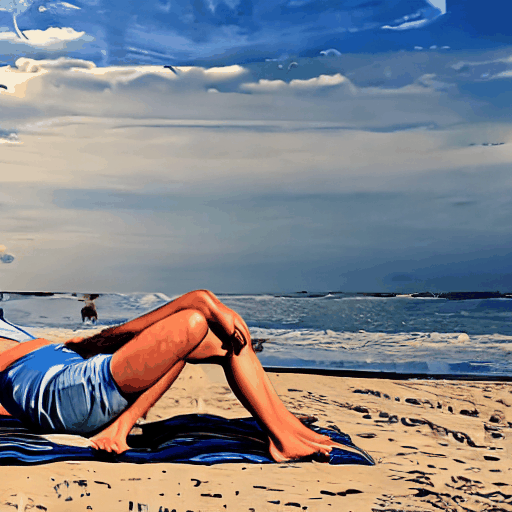

In [ ]:
from base64 import b64encode
import os
from IPython.display import Video, display, HTML
import ipywidgets as widgets

%cd "/content"
# Path to the input directory
input_directory = '/content/input'
gif_directory = '/content/FollowYourPose/checkpoints/inference'
video_files = []
gif_files = []
if os.path.exists(input_directory):
    # Get a list of video files in the input directory
    video_files = [file for file in os.listdir(input_directory) if file.endswith('.mp4')]

if os.path.exists(gif_directory):
    gif_files = [file for file in os.listdir(gif_directory) if file.endswith('.gif')]

# Create a dropdown widget with video file options
video_dropdown = widgets.Dropdown(
    options=video_files,
    description='Select Video:'
)

video_dropdown_gif = widgets.Dropdown(
    options=gif_files,
    description='Select gif:'
)


# Create a button widget for playing the selected video
play_button = widgets.Button(description="Play Video")

# Function to handle button click event
def play_video(event):
    selected_video = video_dropdown.value
    selected_gif = video_dropdown_gif.value
    video_path = os.path.join(input_directory, selected_video)
    gif_path = os.path.join(gif_directory, selected_gif)


    # For Google Collab
    mp4 = open(video_path,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    # Display the MP4 video using HTML video tag
    video_html = f'<video width=400 controls><source src="{data_url}" type="video/mp4"></video>'


    # Read the GIF file and display it
    with open(gif_path, 'rb') as f:
        gif_data = f.read()
    gif_encoded = b64encode(gif_data).decode('utf-8')
    gif_html = f'<img src="data:image/gif;base64,{gif_encoded}" width=400 height=300>'

    # Display videos side by side using inline CSS
    display(HTML(f'<div style="display:flex;justify-content:center;">{video_html}{gif_html}</div>'))

# Attach the function to the button's click event
play_button.on_click(play_video)

# Display the dropdown and button widgets
display(video_dropdown)
display(video_dropdown_gif)
display(play_button)

# **R11** - FID
Able to view some form of metrics to gauge the resultant video performance e.g FID (Fretchet Inception Distance) and ideally we should also be able to see the skeleton from MMPose super-imposed onto the resultant video so that we can observe how the poses translated in the genAI generation.
FID

In [ ]:
# https://github.com/mseitzer/pytorch-fid
# Installing FID Python Library for Project
!pip install pytorch-fid

## Extract Frames of Video into images

In [ ]:
!pip install opencv-python-headless

In [ ]:
import cv2
from ipywidgets import interact, widgets
from IPython.display import display, clear_output
import os

# Select the 2 videos that you wish to extract and be compared
%cd "/content"
# Path to the input directory
real_video_directory = '/content/input'
real_video_frames_directory = '/content/output/frames'
generated_result_video_directory = '/content/input'
real_video_files = []
generated_result_video_files = []

if os.path.exists(real_video_directory):
    # Get a list of video files in the input directory
    real_video_files = [file for file in os.listdir(real_video_directory) if file.endswith('.mp4')]

if os.path.exists(generated_result_video_directory):
    # Get a list of video files in the input directory
    real_video_files = [file for file in os.listdir(generated_result_video_directory) if file.endswith('.mp4')]

# Create a dropdown widget with video file options
real_video_dropdown = widgets.Dropdown(
    options=real_video_files,
    description='Select Real Video:'
)

generated_result_video_dropdown = widgets.Dropdown(
    options=generated_result_video_files,
    description='Select Generated Video:'
)

extract_frames_button = widgets.Button(description="Extract Frames")

def ExtractFrames(video_path, video_name):
  print(f'Extracting {video_name}...')
  video_capture = cv2.VideoCapture(video_path)
  frame_number = 0
  while True:
      # Read a frame from the video
      ret, frame = video_capture.read()

      if not ret:
          break

      # Save the frame as an image
      frame_filename = os.path.join(generated_result_video_directory, f'{video_name}_frame_{frame_number:04d}.png')
      cv2.imwrite(frame_filename, frame)

      frame_number += 1

  # Release the video capture object
  video_capture.release()

def HandleButtonPress(event):
  if real_video_dropdown.value != None:
    ExtractFrames(real_video_directory + real_video_dropdown.value, real_video_dropdown.value)
  else:
    print('please select real video')
  if generated_result_video_dropdown.value != None:
    ExtractFrames(generated_result_video_directory + generated_result_video_dropdown.value, generated_result_video_dropdown.value)
  else:
    print('please select generated result video')

extract_frames_button.on_click(HandleButtonPress)

print('Real Video files pulled from:' + real_video_frames_directory)
display(real_video_dropdown)
print('Generated Result Video files pulled from:' + generated_result_video_directory)
display(generated_result_video_dropdown)
display(extract_frames_button)


/content
Real Video files pulled from:/content/output/frames


Dropdown(description='Select Real Video:', options=(), value=None)

Generated Result Video files pulled from:/content/input


Dropdown(description='Select Generated Video:', options=(), value=None)

Button(description='Extract Frames', style=ButtonStyle())

## FID Comparison

In [ ]:
# To compute the FID score between two datasets, where images of each dataset are contained in an individual folder:
# python -m pytorch_fid path/to/dataset1 path/to/dataset2

# Input files to be compared.
# Compare all frames and get average score?